In [1]:
import matplotlib.pyplot as plt
import networkx as nx
import pandas as pd
import numpy as np

In [36]:
from collections import Counter


In [3]:
facebook = pd.read_csv("/Users/margheritatonon/applied_math_lab/networkx/facebook_combined.txt.gz", compression = "gzip", sep = " ", names = ["start_node", "end_node"])

In [58]:
G = nx.from_pandas_edgelist(facebook, "start_node", "end_node")

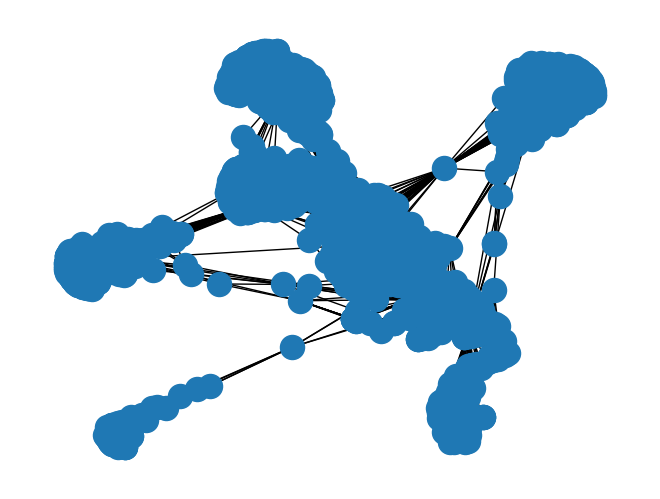

In [5]:
pos = nx.spring_layout(G)
nx.draw(G, pos)
plt.show()

In [ ]:
beta = 0.5 #"infection" rate
gamma = 0.3 #recovery rate

#giving ignorant to every node
state = []
nodes = G.nodes()
for node in nodes:
    state.append((node, "I"))
print(state)
print(len(state))

random_node = np.random.choice(list(G.nodes))
print(random_node)
state = [(node, "S") if node == random_node else (node, "I") for node, _ in state]
print(state)
print(len(state))

[(0, 'I'), (1, 'I'), (2, 'I'), (3, 'I'), (4, 'I'), (5, 'I'), (6, 'I'), (7, 'I'), (8, 'I'), (9, 'I'), (10, 'I'), (11, 'I'), (12, 'I'), (13, 'I'), (14, 'I'), (15, 'I'), (16, 'I'), (17, 'I'), (18, 'I'), (19, 'I'), (20, 'I'), (21, 'I'), (22, 'I'), (23, 'I'), (24, 'I'), (25, 'I'), (26, 'I'), (27, 'I'), (28, 'I'), (29, 'I'), (30, 'I'), (31, 'I'), (32, 'I'), (33, 'I'), (34, 'I'), (35, 'I'), (36, 'I'), (37, 'I'), (38, 'I'), (39, 'I'), (40, 'I'), (41, 'I'), (42, 'I'), (43, 'I'), (44, 'I'), (45, 'I'), (46, 'I'), (47, 'I'), (48, 'I'), (49, 'I'), (50, 'I'), (51, 'I'), (52, 'I'), (53, 'I'), (54, 'I'), (55, 'I'), (56, 'I'), (57, 'I'), (58, 'I'), (59, 'I'), (60, 'I'), (61, 'I'), (62, 'I'), (63, 'I'), (64, 'I'), (65, 'I'), (66, 'I'), (67, 'I'), (68, 'I'), (69, 'I'), (70, 'I'), (71, 'I'), (72, 'I'), (73, 'I'), (74, 'I'), (75, 'I'), (76, 'I'), (77, 'I'), (78, 'I'), (79, 'I'), (80, 'I'), (81, 'I'), (82, 'I'), (83, 'I'), (84, 'I'), (85, 'I'), (86, 'I'), (87, 'I'), (88, 'I'), (89, 'I'), (90, 'I'), (91, 'I'

In [61]:
#giving a random one the fake news
state_dict = dict(state)
print(state_dict)

#updating the graph
nx.set_node_attributes(G, state_dict, "state")

ignorant_nodes = []
spreader_nodes = []
for key, label in state_dict.items():
    if label == "I":
        ignorant_nodes.append(key)
    else:
        spreader_nodes.append(key)

print(ignorant_nodes)
print(spreader_nodes)

#pos = nx.spring_layout(G)
#nx.draw(G, pos = pos, nodelist = ignorant_nodes, node_color = "blue", node_size = 15)
#nx.draw(G, pos = pos, nodelist=spreader_nodes, node_color = "red", node_size = 15)
#plt.show()

{0: 'I', 1: 'I', 2: 'I', 3: 'I', 4: 'I', 5: 'I', 6: 'I', 7: 'I', 8: 'I', 9: 'I', 10: 'I', 11: 'I', 12: 'I', 13: 'I', 14: 'I', 15: 'I', 16: 'I', 17: 'I', 18: 'I', 19: 'I', 20: 'I', 21: 'I', 22: 'I', 23: 'I', 24: 'I', 25: 'I', 26: 'I', 27: 'I', 28: 'I', 29: 'I', 30: 'I', 31: 'I', 32: 'I', 33: 'I', 34: 'I', 35: 'I', 36: 'I', 37: 'I', 38: 'I', 39: 'I', 40: 'I', 41: 'I', 42: 'I', 43: 'I', 44: 'I', 45: 'I', 46: 'I', 47: 'I', 48: 'I', 49: 'I', 50: 'I', 51: 'I', 52: 'I', 53: 'I', 54: 'I', 55: 'I', 56: 'I', 57: 'I', 58: 'I', 59: 'I', 60: 'I', 61: 'I', 62: 'I', 63: 'I', 64: 'I', 65: 'I', 66: 'I', 67: 'I', 68: 'I', 69: 'I', 70: 'I', 71: 'I', 72: 'I', 73: 'I', 74: 'I', 75: 'I', 76: 'I', 77: 'I', 78: 'I', 79: 'I', 80: 'I', 81: 'I', 82: 'I', 83: 'I', 84: 'I', 85: 'I', 86: 'I', 87: 'I', 88: 'I', 89: 'I', 90: 'I', 91: 'I', 92: 'I', 93: 'I', 94: 'I', 95: 'I', 96: 'I', 97: 'I', 98: 'I', 99: 'I', 100: 'I', 101: 'I', 102: 'I', 103: 'I', 104: 'I', 105: 'I', 106: 'I', 107: 'I', 108: 'I', 109: 'I', 110: 'I',

In [63]:
i = 0
truth = []
for key, value in state_dict.items():
    #print(key)
    truth.append(i == key)
    #print(i == key)
    i = i + 1
print(truth)
print(Counter(truth).keys())
print(Counter(truth).values())
print(sum(Counter(truth).values()))

[True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, Tru

In [64]:
print(len(state_dict))

4039


In [65]:
#not doing a for loop because it was glitching
state = nx.get_node_attributes(G, "state")
new_state = {}
for node in G.nodes():
    if state_dict[node] == "I":
        print(node)
        neighbors = list(G.neighbors(node))

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [ ]:
iterations = 10
dictionaries_list = []

#whole update rules
for iters in range(iterations):
    state = nx.get_node_attributes(G, "state")
    new_state = {}
    for node in G.nodes():
        print(node)
        try:
            if state_dict[node] == "I":
                #checking the neighbors
                neighbors = list(G.neighbors(node))
                print(neighbors)
                #we need to access the neighbors whose states is S
                print(type(state_dict))
                all_values = state_dict.values()
                print(all_values)
        except:
            pass

    state_dict.update(new_state)
    dictionaries_list.append(state_dict.copy())


            #neighbor_df = dictionarydf[neighbors]
            #print(neighbor_df)
"""
            for neighbor in neighbors:
                if state_dict[neighbor] == "S":
                    if np.random.uniform(0, 1) < beta:
                        new_state[node] = "S"
                        break
        elif state_dict[node] == "S":
            neighbors = list(G.neighbors(node))
            #accessing the 

            for neighbor in neighbors:
                if np.random.uniform(0, 1) < gamma:
                    new_state[node] = "R"
                    """


0
[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 

KeyError: 2189

In [ ]:
#if we have an ignorant node, for every spreader node near it we have a probability beta of the ignorant node becoming a spreader
#if we have a spreader node, for every spreader node near it we have a probability gamma of the spreader node becoming recovered
#recovered stay recovered